# DAVIS 2016 - Load and Inspect Dataset (no Augmentation)

In this notebook we:
- Load the 2016 dataset and create the additional data necessary to train MaskRNN (see below)
- Show sample videos along with the MaskRNN additional data

In [1]:
import sys
import time
import random
import datasets
import visualize
%matplotlib inline
%load_ext autoreload

## Load
Load the DAVIS 2016 dataset and do all the processing necessary for MaskRNN training. This will take a while if data augmentation is enabled!

In [2]:
# Configure - *SET* dataset_root to the correct path on your machine!
dataset_root = 'E:/datasets/davis2016/' if sys.platform.startswith("win") else '/media/EDrive/datasets/davis2016/'
train_file = dataset_root + 'ImageSets/480p/train.txt'
options = datasets._DEFAULT_DAVIS16_OPTIONS
options['data_aug'] = False

In [3]:
# Load data
start = time.time()
dataset = datasets.davis16(train_file, None, dataset_root, options)
end = time.time()
m, s = divmod(end - start, 60)
h, m = divmod(m, 60)
print('Time Taken: {:2.0f}h{:2.0f}m{:2.0f}s for {} videos (includes augmentation time, if any).'.format(h, m, s, dataset.num_videos))

Initializing dataset...
E:/datasets/davis2016/ImageSets/480p/train.txt
Cache files:
   videos container: E:/datasets/davis2016/davis2016_videos_train.npy
   video_frame_idx container: E:/datasets/davis2016/davis2016_video_frame_idx_train.npy
   images_train container: E:/datasets/davis2016/davis2016_images_train.npy
   images_train_path container: E:/datasets/davis2016/davis2016_images_train_path.npy
   masks_train container: E:/datasets/davis2016/davis2016_masks_train.npy
   masks_train_path container: E:/datasets/davis2016/davis2016_masks_train_path.npy
   flow_norms_train container: E:/datasets/davis2016/davis2016_flow_norms_train.npy
   warped_prev_masks_train container: E:/datasets/davis2016/davis2016_warped_prev_masks_train.npy
   masks_bboxes_train container: E:/datasets/davis2016/davis2016_masks_bboxes_train.npy
Loading ndarrays from cache...
 videos container... done.
 video_frame_idx container... done.
 images_train container... done.
 images_train_path container... done.
 ma

In [4]:
# Display dataset configuration
dataset.print_config()


Configuration:
  in_memory            True
  data_aug             False
  use_cache            True
  use_optical_flow     True
  use_warped_masks     True
  use_bboxes           True
  optical_flow_mgr     pyflow


## Inspect original dataset

Choose a few videos to inspect (includes data augmented videos) at random.
> Naming convention example: `bear_sc_0.5_fl`, bear video scaled by 0.5 factor and flipped vertically

In [5]:
subset = 1 # Choose [1|2|3]
random.seed(1)
videos = random.sample(list(dataset.videos.keys()), subset)
print('Chosen videos: {} out of {} videos'.format(videos, dataset.num_videos))

Chosen videos: ['bus'] out of 30 videos


Build a list of individual video frames with:
- video frames overlaid with groundtruth masks (red) and computed mask bounding boxes (blue)
- video frames overlaid with previous-frame masks (green) warped based on the optical flow measured betwwen the previous frame and the current frame, as well as the computed mask bounding box for this warped mask (yellow)
- both combined (useful to see how "off" the optical flow predictions are)

In [6]:
# Show the individual video frames with groundtruth masks (red) and computed mask bounding boxes (yellow)
frames_with_gt_masks = {}
frames_with_warped_masks = {}
frames_with_both_masks = {}
for video in videos:
    frames_with_gt_masks[video] = dataset.create_frames_with_overlays(video, mode='gt')
    frames_with_warped_masks[video] = dataset.create_frames_with_overlays(video, mode='warped')
    frames_with_both_masks[video] = dataset.create_frames_with_overlays(video, mode='gt_warped')

## Display individual frames

Show the individual video frames overlaid with groundtruth masks (red) and computed mask bounding boxes (blue)

bus (groundtruth):


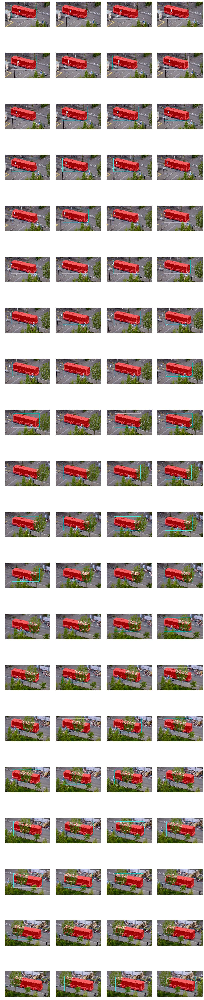

In [7]:
for video in videos:
    print('{} (groundtruth):'.format(video))
    visualize.display_images(frames_with_gt_masks[video])

Show the overlaid with previous-frame masks (green) warped based on the optical flow measured betwwen the previous frame and the current frame, as well as the computed mask bounding box for this warped mask (yellow)

bus (warped masks from flow):


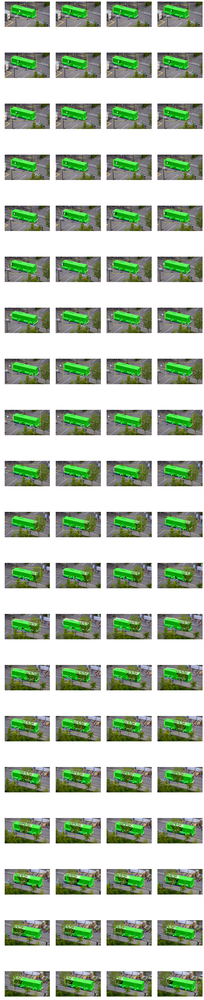

In [8]:
for video in videos:
    print('{} (warped masks from flow):'.format(video))
    visualize.display_images(frames_with_warped_masks[video])

Show both combined (useful to see how "off" the optical flow predictions are)

bus (groaundtruth masks and warped masks from flow):


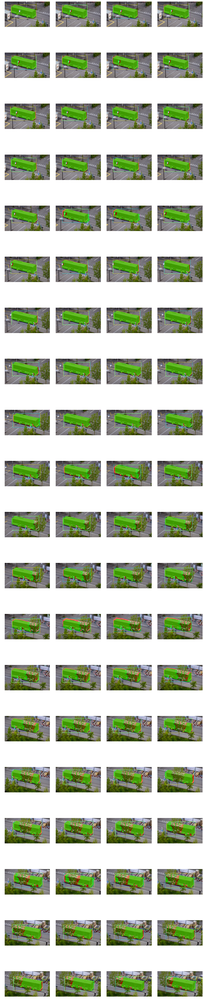

In [9]:
for video in videos:
    print('{} (groaundtruth masks and warped masks from flow):'.format(video))
    visualize.display_images(frames_with_both_masks[video])

## Display videos

The content of the clips below is the same as above but rather than showing individual frames with their overlays, we re-create the entire video sequence with overlays. The clips help get a better sense of what kind of motion is displacing the warped masks away from their groundtruths.

In [10]:
video_clip_folder = dataset_root + 'clips/'

### Build the video clips

In [11]:
# Same as above, but this time turn the images into a MP4 video clip
for video in videos:
    print('{}'.format(video))
    visualize.make_clip(video_clip_folder + video + '_gt.mp4', frames_with_gt_masks[video])
    visualize.make_clip(video_clip_folder + video + '_wrp.mp4', frames_with_warped_masks[video])
    visualize.make_clip(video_clip_folder + video + '_gt_wrp.mp4', frames_with_both_masks[video])

bus


## Display videos

### Groundtruths

In [12]:
video_clips = [video_clip_folder + videos[video] + '_gt.mp4' for video in range(subset)]

In [13]:
visualize.show_clips(video_clips)

### Masks warped by optical flow

In [14]:
video_clips = [video_clip_folder + videos[video] + '_wrp.mp4' for video in range(subset)]

In [15]:
visualize.show_clips(video_clips)

# Groundtruth masks and masks warped by optical flow

In [16]:
video_clips = [video_clip_folder + videos[video] + '_gt_wrp.mp4' for video in range(subset)]

In [17]:
visualize.show_clips(video_clips)